In [234]:
import pandas as pd
import re
import os
import numpy as np 
import matplotlib.pyplot as plt
import geopandas as gpd
import requests
from shapely.geometry import Point, MultiPolygon
from urllib3.util import Retry
from tenacity import retry, stop_after_attempt, wait_exponential
from shapely.ops import nearest_points
from requests.adapters import HTTPAdapter
from concurrent.futures import ThreadPoolExecutor, as_completed
import folium
import math
import pyproj
from itertools import chain
from pandas.plotting import scatter_matrix 
import seaborn as sns
from sklearn.neighbors import BallTree
from sklearn import set_config
from sklearn.pipeline import make_pipeline, Pipeline
from sklearn.preprocessing import FunctionTransformer, StandardScaler, PowerTransformer, OneHotEncoder
from sklearn.compose import ColumnTransformer
from sklearn.linear_model import LinearRegression, LogisticRegression
from sklearn.model_selection import train_test_split
from sklearn.base import BaseEstimator, TransformerMixin
from sklearn.metrics import mean_absolute_error, mean_squared_error, r2_score
from sklearn.tree import DecisionTreeRegressor, DecisionTreeClassifier, plot_tree
from sklearn.model_selection import cross_val_score 
from sklearn.ensemble import RandomForestRegressor, RandomForestClassifier
from sklearn.model_selection import GridSearchCV
from sklearn.metrics import accuracy_score, precision_score, recall_score, f1_score, roc_auc_score
from sklearn.metrics import confusion_matrix
from dbfread import DBF
from sklearn.preprocessing import LabelEncoder
from functools import reduce








set_config(display='diagram')

# Creating a CSV from the photos

In [235]:
# Path to the folder containing the photos
folder_path = '/Users/joseph/SRC/Maters/New/Jan/new/CheckingImageCollection/AllImagesFeb'  # Replace with your actual folder path

# List all files in the folder
file_list = [file for file in os.listdir(folder_path) if os.path.isfile(os.path.join(folder_path, file))]

# Create a DataFrame
Photos = pd.DataFrame(file_list, columns=['filename'])

In [236]:
def extract_components(filename):
    pattern = r'!?([^_]+)_(\d+)_(\d+)--([-.\d,]+)\.jpg'
    match = re.match(pattern, filename)
    if match:
        return match.groups()
    else:
        return [None, None, None, None]


In [237]:
Photos[['Municipality', 'OSM_ID', 'WARDID', 'CoordinateValue']] = Photos['filename'].apply(lambda x: pd.Series(extract_components(x)))


In [238]:
Photos = Photos.groupby(["Municipality"]).size().reset_index(name="sum")


In [239]:
Photos = Photos.rename(columns={'sum': 'NuPhotos'})


In [240]:
Photos

,Municipality,NuPhotos
0,abaqulusi,521
1,alfred duma,901
2,amahlathi,304
3,ba-phalaborwa,645
4,beaufort west,570
...,...,...
207,uphongolo,235
208,victor khanye,643
209,walter sisulu,558
210,winnie madikizela-mandela,366


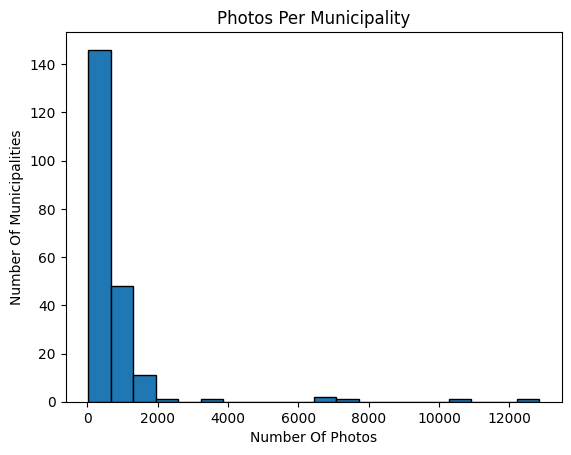

In [241]:

# Plot histogram
plt.hist(Photos['NuPhotos'], bins=20, edgecolor='black')

# Labels and title
plt.xlabel('Number Of Photos')
plt.ylabel('Number Of Municipalities')
plt.title('Photos Per Municipality')

# Show plot
plt.show()


# Reading Inference

### ReadingInference For Potholes and People

In [242]:
potholes = pd.read_csv('/Users/joseph/SRC/Maters/New/Feb/CSVCreation/Potholes/InferencePeople.csv')
people = pd.read_csv('/Users/joseph/SRC/Maters/New/Feb/CSVCreation/Potholes/InferencePotholes.csv')
trash = pd.read_csv('/Users/joseph/SRC/Maters/New/Feb/CSVCreation/Potholes/InferenceTrash.csv')
vehicles = pd.read_csv('/Users/joseph/SRC/Maters/New/Feb/CSVCreation/Potholes/InferenceCars.csv')

In [243]:
vehicles['class'].unique()

array([3, 1, 0, 2])

In [244]:
buses = vehicles[vehicles['class'] == 0]
cars = vehicles[vehicles['class'] == 1]
motorbikes = vehicles[vehicles['class'] == 2]
trucks = vehicles[vehicles['class'] == 3]



In [245]:
def extract_components(filename):
    pattern = r'!?([^_]+)_(\d+)_(\d+)--([-.\d,]+)\.jpg'
    match = re.match(pattern, filename)
    if match:
        return match.groups()
    else:
        return [None, None, None, None]


In [246]:
people[['Municipality', 'OSM_ID', 'WARDID', 'CoordinateValue']] = people['filename'].apply(lambda x: pd.Series(extract_components(x)))
potholes[['Municipality', 'OSM_ID', 'WARDID', 'CoordinateValue']] = potholes['filename'].apply(lambda x: pd.Series(extract_components(x)))
trash[['Municipality', 'OSM_ID', 'WARDID', 'CoordinateValue']] = trash['filename'].apply(lambda x: pd.Series(extract_components(x)))
cars[['Municipality', 'OSM_ID', 'WARDID', 'CoordinateValue']] = cars['filename'].apply(lambda x: pd.Series(extract_components(x)))
buses[['Municipality', 'OSM_ID', 'WARDID', 'CoordinateValue']] = buses['filename'].apply(lambda x: pd.Series(extract_components(x)))
motorbikes[['Municipality', 'OSM_ID', 'WARDID', 'CoordinateValue']] = motorbikes['filename'].apply(lambda x: pd.Series(extract_components(x)))
trucks[['Municipality', 'OSM_ID', 'WARDID', 'CoordinateValue']] = trucks['filename'].apply(lambda x: pd.Series(extract_components(x)))




/var/folders/20/l853m0wd02b4mwcklpnsdqx40000gn/T/ipykernel_55552/1410151993.py:4: SettingWithCopyWarning: 
A value is trying to be set on a copy of a slice from a DataFrame.
Try using .loc[row_indexer,col_indexer] = value instead

See the caveats in the documentation: https://pandas.pydata.org/pandas-docs/stable/user_guide/indexing.html#returning-a-view-versus-a-copy
  cars[['Municipality', 'OSM_ID', 'WARDID', 'CoordinateValue']] = cars['filename'].apply(lambda x: pd.Series(extract_components(x)))
/var/folders/20/l853m0wd02b4mwcklpnsdqx40000gn/T/ipykernel_55552/1410151993.py:4: SettingWithCopyWarning: 
A value is trying to be set on a copy of a slice from a DataFrame.
Try using .loc[row_indexer,col_indexer] = value instead

See the caveats in the documentation: https://pandas.pydata.org/pandas-docs/stable/user_guide/indexing.html#returning-a-view-versus-a-copy
  cars[['Municipality', 'OSM_ID', 'WARDID', 'CoordinateValue']] = cars['filename'].apply(lambda x: pd.Series(extract_components

In [247]:
def plot_probability(dataframe, name):
    # Define the confidence intervals (buckets)
    bins = np.arange(0, 1.05, 0.05)  # Intervals: 0-0.05, 0.05-0.1, ..., 0.95-1.0

    # Create a histogram to count Wards in each bucket
    counts, edges = np.histogram(dataframe["confidence"], bins=bins)

    # Plot the bar chart
    plt.figure(figsize=(10, 6))
    plt.bar(
        x=[f"{edges[i]:.1f}-{edges[i+1]:.1f}" for i in range(len(edges) - 1)],  # Bucket labels
        height=counts,  # Counts in each bucket
        color="blue", alpha=0.7
    )

    # Add labels and title
    plt.xlabel("Confidence Interval", fontsize=12)
    plt.ylabel("Number of Photos", fontsize=12)
    plt.title(f"Distribution of {name} by Confidence Intervals", fontsize=14)  # Modified title
    plt.xticks(rotation=45, fontsize=10)

    # Show the plot
    plt.tight_layout()
    plt.show()
    

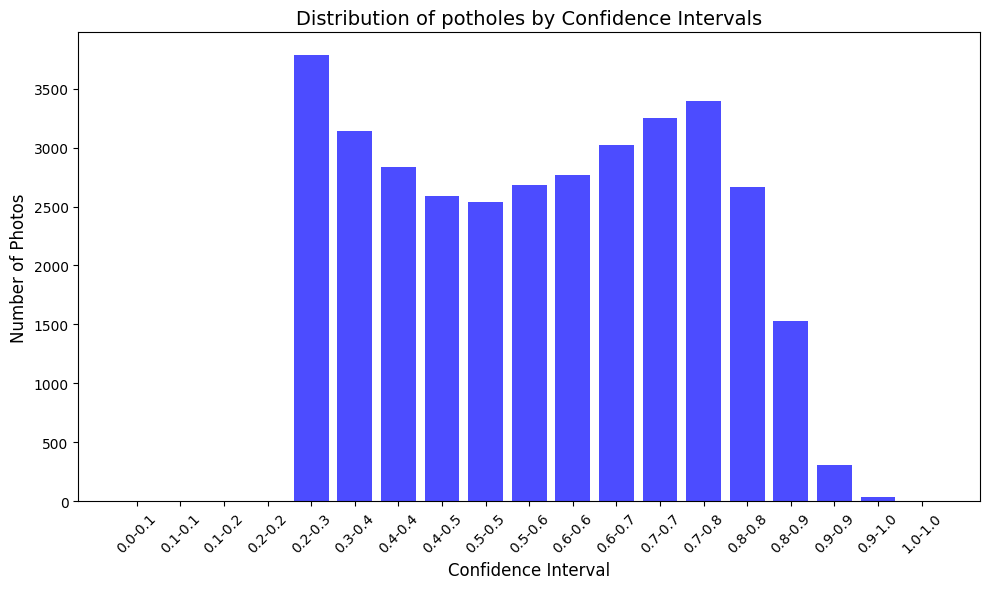

In [248]:
plot_probability(potholes,"potholes")

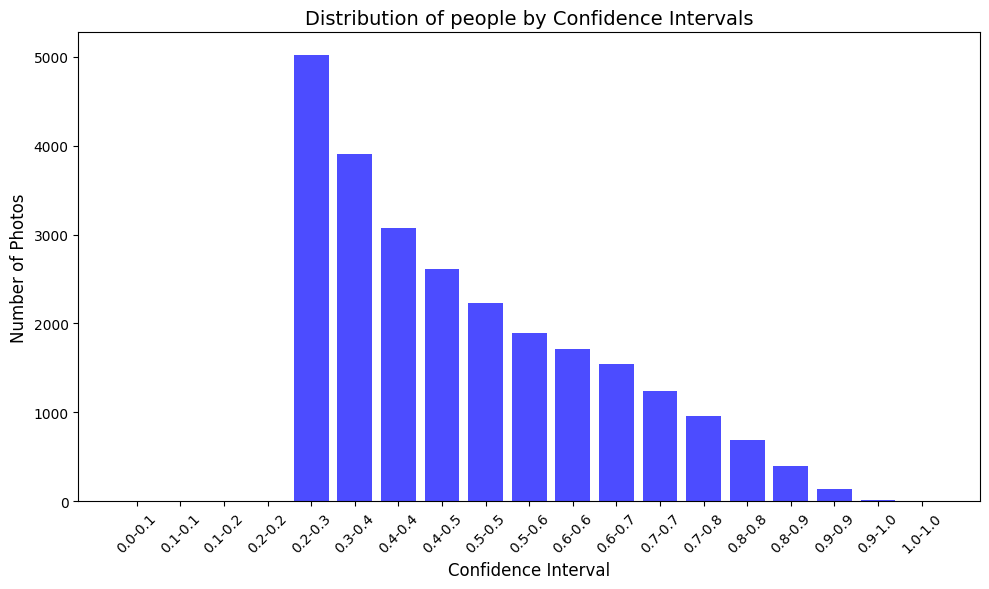

In [249]:
plot_probability(people,"people")

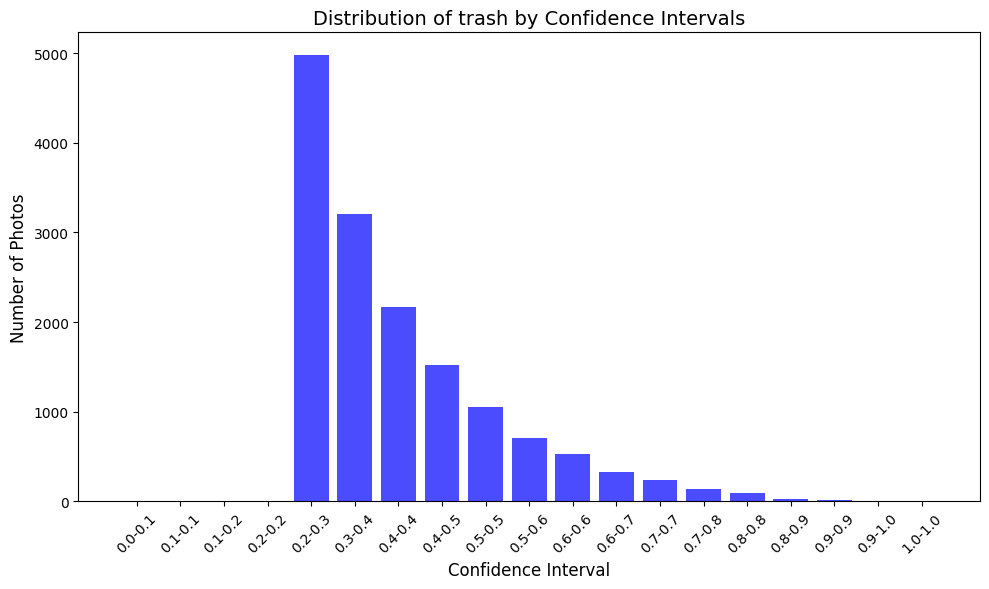

In [250]:
plot_probability(trash,"trash")

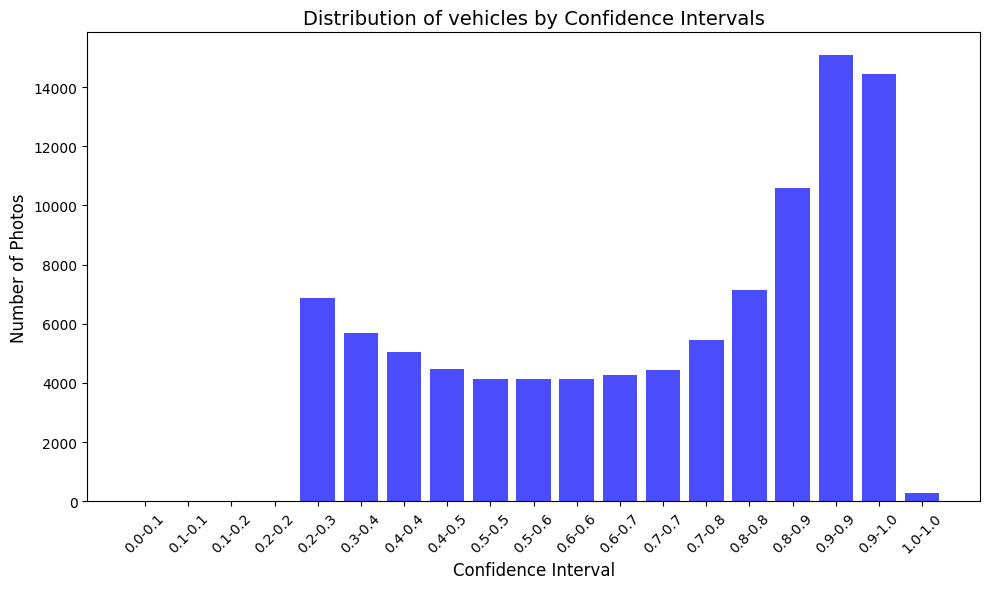

In [251]:
plot_probability(vehicles,"vehicles")

In [252]:
potholes = potholes[potholes['confidence'] > 0.3]
people = people[people['confidence'] > 0.3]
trash = trash[trash['confidence'] > 0.3]
cars = cars[cars['confidence'] > 0.3]

In [253]:
def grouping(df,column_name):
    df = df[['Municipality']]
    df = df.groupby(["Municipality"]).size().reset_index(name="sum")
    df = df.rename(columns={'sum': column_name})
    return df

In [254]:
potholes = grouping(potholes,"Potholes")
people = grouping(people,"People")
trash = grouping(trash,"Trash")
cars = grouping(cars,"Cars")
buses = grouping(buses,"Buses")
motorbikes = grouping(motorbikes,"Motorbikes")
trucks = grouping(trucks,"Trucks")

### Adding in missing wards for Inference

In [255]:
def add_missing_wards(Photos, dataframe, column_name):
    # Identify missing wards
    Wards_not_in_Photos = set(Photos["Municipality"].unique()) - set(dataframe["Municipality"].unique())

    # Create a DataFrame for the missing wards with zero values, except for Municipality
    missing_wards_df = pd.DataFrame({
        "Municipality": list(Wards_not_in_Photos),
        column_name: 0,  # Example column
    })

    # Append the missing rows to the original DataFrame
    dataframe = pd.concat([dataframe, missing_wards_df], ignore_index=True)
    return dataframe

In [256]:
potholes = add_missing_wards(Photos, potholes, "Potholes")
people = add_missing_wards(Photos, people, "People")
trash = add_missing_wards(Photos, trash, "Trash")
cars = add_missing_wards(Photos, cars, "Cars")  
buses = add_missing_wards(Photos, buses, "Buses")
motorbikes = add_missing_wards(Photos, motorbikes, "Motorbikes")
trucks = add_missing_wards(Photos, trucks, "Trucks")

In [257]:
# List of dataframes to merge
dfs = [people, potholes, trash, cars, buses,motorbikes,trucks, Photos]

# Merge all DataFrames on 'Municipality'
merged_df = reduce(lambda left, right: pd.merge(left, right, on='Municipality'), dfs)

In [258]:
merged_df

,Municipality,People,Potholes,Trash,Cars,Buses,Motorbikes,Trucks,NuPhotos
0,abaqulusi,94,92,29,184,2,20,7,521
1,alfred duma,87,120,51,310,12,16,16,901
2,amahlathi,107,65,17,216,4,12,7,304
3,ba-phalaborwa,255,97,30,264,8,20,11,645
4,beaufort west,61,112,33,156,2,20,10,570
...,...,...,...,...,...,...,...,...,...
207,uphongolo,23,41,22,73,7,10,40,235
208,victor khanye,132,137,24,243,8,37,22,643
209,walter sisulu,95,136,28,191,3,17,17,558
210,winnie madikizela-mandela,6,54,20,164,6,11,13,366


In [259]:
merged_df['PotholeRatio'] = merged_df['Potholes'] / merged_df['NuPhotos']
merged_df['PeopleRatio'] = merged_df['People'] / merged_df['NuPhotos']
merged_df['TrashRatio'] = merged_df['Trash'] / merged_df['NuPhotos']
merged_df['CarRatio'] = merged_df['Cars'] / merged_df['NuPhotos']
merged_df['BusRatio'] = merged_df['Buses'] / merged_df['NuPhotos']
merged_df['TruckRatio'] = merged_df['Trucks'] / merged_df['NuPhotos']   
merged_df['MotorbikeRatio'] = merged_df['Motorbikes'] / merged_df['NuPhotos']
merged_df

,Municipality,People,Potholes,Trash,Cars,Buses,Motorbikes,Trucks,NuPhotos,PotholeRatio,PeopleRatio,TrashRatio,CarRatio,BusRatio,TruckRatio,MotorbikeRatio
0,abaqulusi,94,92,29,184,2,20,7,521,0.176583,0.180422,0.055662,0.353167,0.003839,0.013436,0.038388
1,alfred duma,87,120,51,310,12,16,16,901,0.133185,0.096559,0.056604,0.344062,0.013319,0.017758,0.017758
2,amahlathi,107,65,17,216,4,12,7,304,0.213816,0.351974,0.055921,0.710526,0.013158,0.023026,0.039474
3,ba-phalaborwa,255,97,30,264,8,20,11,645,0.150388,0.395349,0.046512,0.409302,0.012403,0.017054,0.031008
4,beaufort west,61,112,33,156,2,20,10,570,0.196491,0.107018,0.057895,0.273684,0.003509,0.017544,0.035088
...,...,...,...,...,...,...,...,...,...,...,...,...,...,...,...,...
207,uphongolo,23,41,22,73,7,10,40,235,0.174468,0.097872,0.093617,0.310638,0.029787,0.170213,0.042553
208,victor khanye,132,137,24,243,8,37,22,643,0.213064,0.205288,0.037325,0.377916,0.012442,0.034215,0.057543
209,walter sisulu,95,136,28,191,3,17,17,558,0.243728,0.170251,0.050179,0.342294,0.005376,0.030466,0.030466
210,winnie madikizela-mandela,6,54,20,164,6,11,13,366,0.147541,0.016393,0.054645,0.448087,0.016393,0.035519,0.030055


# Roads

In [260]:
roads = gpd.read_file('/Users/joseph/SRC/Maters/New/Feb/CSVCreation/Take1/Data/Shapefiles/south-africa-latest-free.shp/gis_osm_roads_free_1.shp')

In [261]:
roads.drop(['code','ref','name','oneway', 'maxspeed','layer','bridge','tunnel'], axis=1, inplace=True)

In [262]:
usefullRoads = roads[roads['fclass'].isin([ 'tertiary','residential','secondary'])]

### Existing Roads

In [263]:
# Read the CSV file into a dataframe
EC = pd.read_csv('/Users/joseph/SRC/Maters/New/Feb/CSVCreation/Take1/Data/Shapefiles/ProvincesStreetViewRoads/Eastern Cape.csv')
FS = pd.read_csv('/Users/joseph/SRC/Maters/New/Feb/CSVCreation/Take1/Data/Shapefiles/ProvincesStreetViewRoads/Free State.csv')
GP = pd.read_csv('/Users/joseph/SRC/Maters/New/Feb/CSVCreation/Take1/Data/Shapefiles/ProvincesStreetViewRoads/Gauteng.csv')
KZN = pd.read_csv('/Users/joseph/SRC/Maters/New/Feb/CSVCreation/Take1/Data/Shapefiles/ProvincesStreetViewRoads/KwaZulu-Natal.csv')
MP = pd.read_csv('/Users/joseph/SRC/Maters/New/Feb/CSVCreation/Take1/Data/Shapefiles/ProvincesStreetViewRoads/Limpopo.csv')
NC = pd.read_csv('/Users/joseph/SRC/Maters/New/Feb/CSVCreation/Take1/Data/Shapefiles/ProvincesStreetViewRoads/Mpumalanga.csv')
NW = pd.read_csv('/Users/joseph/SRC/Maters/New/Feb/CSVCreation/Take1/Data/Shapefiles/ProvincesStreetViewRoads/North West.csv')
WC = pd.read_csv('/Users/joseph/SRC/Maters/New/Feb/CSVCreation/Take1/Data/Shapefiles/ProvincesStreetViewRoads/Northern Cape.csv')
lm = pd.read_csv('/Users/joseph/SRC/Maters/New/Feb/CSVCreation/Take1/Data/Shapefiles/ProvincesStreetViewRoads/Western Cape.csv')


combined_df = pd.concat([EC, FS, GP, KZN, MP, WC, NC, NW,lm])

In [264]:
exists = combined_df[(combined_df['status1'] == 1) & (combined_df['status2'] == 1)]
exists['osm_id'] = exists['osm_id'].astype(str)

/var/folders/20/l853m0wd02b4mwcklpnsdqx40000gn/T/ipykernel_55552/669118614.py:2: SettingWithCopyWarning: 
A value is trying to be set on a copy of a slice from a DataFrame.
Try using .loc[row_indexer,col_indexer] = value instead

See the caveats in the documentation: https://pandas.pydata.org/pandas-docs/stable/user_guide/indexing.html#returning-a-view-versus-a-copy
  exists['osm_id'] = exists['osm_id'].astype(str)


In [265]:
# This is a dataframe of of all the roads that exist
exists.shape

(327154, 15)

In [266]:
usefullRoads['match'] = usefullRoads['osm_id'].isin(exists['osm_id']).astype(int)

/opt/miniconda3/envs/streerview/lib/python3.12/site-packages/geopandas/geodataframe.py:1819: SettingWithCopyWarning: 
A value is trying to be set on a copy of a slice from a DataFrame.
Try using .loc[row_indexer,col_indexer] = value instead

See the caveats in the documentation: https://pandas.pydata.org/pandas-docs/stable/user_guide/indexing.html#returning-a-view-versus-a-copy
  super().__setitem__(key, value)


In [267]:
# This is now a dataframe of all roads and whether they exist or not - we then need to merge this to Ward :)
usefullRoads

,osm_id,fclass,geometry,match
0,3715718,residential,"LINESTRING (25.55753 -33.95111, 25.55891 -33.9...",1
2,3823543,residential,"LINESTRING (25.55782 -33.95025, 25.5579 -33.95...",1
3,3823545,residential,"LINESTRING (25.55837 -33.94864, 25.55829 -33.9...",1
4,3823547,residential,"LINESTRING (25.55968 -33.95414, 25.55974 -33.9...",1
5,3845300,residential,"LINESTRING (25.55725 -33.95197, 25.55914 -33.9...",1
...,...,...,...,...
1877439,1300644672,residential,"LINESTRING (28.19391 -25.9775, 28.1938 -25.977...",0
1877440,1300644673,residential,"LINESTRING (28.19075 -25.97778, 28.1907 -25.97...",0
1877441,1300653750,residential,"LINESTRING (26.18558 -29.05951, 26.18612 -29.0...",0
1877442,1300664869,residential,"LINESTRING (18.732 -34.01397, 18.73217 -34.013...",1


In [268]:
Mun = gpd.read_file('/Users/joseph/SRC/Maters/New/Feb/CSVCreation/Take1/Data/Shapefiles/MDB_Local_Municipal_Boundary_2018/MDB_Local_Municipal_Boundary_2018.shp')
Mun.rename(columns={'MUNICNAME': 'Municipality'}, inplace=True)

In [269]:
# Converting incorrect municipality names
Mun.loc[Mun['Municipality'] == 'Dr AB Xuma', 'Municipality'] = 'Engcobo'
Mun.loc[Mun['Municipality'] == 'The Msunduzi', 'Municipality'] = 'Msunduzi'
Mun.loc[Mun['Municipality'] == 'Mfolozi', 'Municipality'] = 'uMfolozi'
Mun.loc[Mun['Municipality'] == 'Msinga', 'Municipality'] = 'uMsinga'
Mun.loc[Mun['Municipality'] == 'Lepelle-Nkumpi', 'Municipality'] = 'Lepele-Nkumpi'
Mun.loc[Mun['Municipality'] == 'Thembisile', 'Municipality'] = 'Thembisile Hani'
Mun.loc[Mun['Municipality'] == 'City of Matlosana', 'Municipality'] = 'Matlosana'
Mun.loc[Mun['Municipality'] == 'Local Municipality of Madibeng', 'Municipality'] = 'Madibeng'
Mun.loc[Mun['Municipality'] == 'Kagisano-Molopo', 'Municipality'] = 'GanyesaPomfret'
Mun.loc[Mun['Municipality'] == 'Maluti-a-Phofung', 'Municipality'] = 'Maluti a Phofung'
Mun.loc[Mun['Municipality'] == 'Khâi-Ma', 'Municipality'] = 'KhaiMa'
Mun.loc[(Mun['Municipality'] == 'Emalahleni') & (Mun['PROVINCE'] == 'EC'), 'Municipality'] = 'Emalaheleniec'
Mun.loc[(Mun['Municipality'] == 'Emalahleni') & (Mun['PROVINCE'] == "MP"), 'Municipality'] = 'Emalahelenimp'
Mun.loc[Mun['Municipality'] == '!Kheis', 'Municipality'] = 'kheis'


Mun = Mun[['Municipality', 'geometry']]
Mun['Municipality'] = Mun['Municipality'].str.lower()



In [270]:
Mun

,Municipality,geometry
0,overstrand,"MULTIPOLYGON (((19.41807 -34.68668, 19.41807 -..."
1,cape agulhas,"POLYGON ((20.06351 -34.21699, 20.06491 -34.233..."
2,theewaterskloof,"POLYGON ((19.2974 -33.88968, 19.31055 -33.9137..."
3,mossel bay,"POLYGON ((22.12817 -33.85624, 22.13423 -33.869..."
4,hessequa,"POLYGON ((21.74781 -33.81114, 21.74785 -33.811..."
...,...,...
208,collins chabane,"POLYGON ((31.3449 -22.53453, 31.34739 -22.5420..."
209,thulamela,"POLYGON ((30.91065 -22.47558, 30.91192 -22.475..."
210,blouberg,"POLYGON ((28.87529 -22.44745, 28.8773 -22.4474..."
211,musina,"POLYGON ((29.67528 -22.13901, 29.67583 -22.139..."


### Adding Ward To Roads

In [271]:
# Define the target CRS
tgt_crs = 'EPSG:3857'  # GCS_WGS_1984

# Transform the CRS of the entire GeoDataFrame
Mun = Mun.to_crs(tgt_crs)
usefullRoads = usefullRoads.to_crs(tgt_crs)

In [272]:
MunRoads = gpd.sjoin(usefullRoads, Mun, how='left', predicate='within')

In [273]:
MunRoads.drop(['index_right'], axis=1, inplace=True)


In [274]:
MunRoads.dropna(inplace=True)

### Getting the missing roads

In [275]:
missingRoads = usefullRoads[~usefullRoads['osm_id'].isin(MunRoads['osm_id'])]

In [276]:
# Perform a spatial join that allows multiple matches (each LineString might intersect multiple geometries)
missingMergedRoads = gpd.sjoin(missingRoads, Mun, how='left', predicate='intersects')

# Calculate the length of each intersection between the LineString and the geometry
missingMergedRoads['intersection_length'] = missingMergedRoads.apply(lambda row: row.geometry.intersection(row['geometry']).length, axis=1)

# Sort by osm_id and intersection_length in descending order to have the largest intersection first
missingMergedRoads = missingMergedRoads.sort_values(by=['osm_id', 'intersection_length'], ascending=[True, False])

# Drop duplicates, keeping only the first occurrence (which has the largest intersection)
missingMergedRoads = missingMergedRoads.drop_duplicates(subset='osm_id', keep='first')

In [277]:
missingMergedRoads.drop(['index_right'], axis=1, inplace=True)
# Specify the desired column order
column_order = ['osm_id', 'fclass','geometry', 'match','Municipality']

# Reindex the dataframe with the desired column order
missingMergedRoads = missingMergedRoads.reindex(columns=column_order)

In [278]:
missingMergedRoads.dropna(inplace=True)

In [279]:
MunRoads = pd.concat([MunRoads, missingMergedRoads], axis=0)

In [280]:
Temp = MunRoads.copy()

In [281]:
Temp['Exist'] = Temp['match']
Temp['DNExist'] = 1 - Temp['match']

In [282]:
Temp.drop(['match','osm_id', 'fclass', 'geometry'], axis=1, inplace=True)


In [283]:
GroupedRoads = Temp.groupby("Municipality")[["Exist", "DNExist"]].sum().reset_index()


In [284]:
GroupedRoads

,Municipality,Exist,DNExist
0,abaqulusi,359,3647
1,alfred duma,1142,4202
2,amahlathi,117,2714
3,ba-phalaborwa,416,2720
4,beaufort west,375,646
...,...,...,...
208,uphongolo,111,3661
209,victor khanye,429,1148
210,walter sisulu,334,1295
211,winnie madikizela-mandela,159,4086


### Adding Merged_Df

In [285]:
merged_df = pd.merge(GroupedRoads, merged_df, on='Municipality')

In [286]:
merged_df['NuRoads']=merged_df['Exist']+merged_df['DNExist']
merged_df['RoadRatio'] = merged_df['Exist'] / merged_df['NuRoads']
merged_df.loc[merged_df['DNExist'] == 0, 'RoadRatio'] = 1  #### what about if there are no roads...
merged_df

,Municipality,Exist,DNExist,People,Potholes,Trash,Cars,Buses,Motorbikes,Trucks,NuPhotos,PotholeRatio,PeopleRatio,TrashRatio,CarRatio,BusRatio,TruckRatio,MotorbikeRatio,NuRoads,RoadRatio
0,abaqulusi,359,3647,94,92,29,184,2,20,7,521,0.176583,0.180422,0.055662,0.353167,0.003839,0.013436,0.038388,4006,0.089616
1,alfred duma,1142,4202,87,120,51,310,12,16,16,901,0.133185,0.096559,0.056604,0.344062,0.013319,0.017758,0.017758,5344,0.213698
2,amahlathi,117,2714,107,65,17,216,4,12,7,304,0.213816,0.351974,0.055921,0.710526,0.013158,0.023026,0.039474,2831,0.041328
3,ba-phalaborwa,416,2720,255,97,30,264,8,20,11,645,0.150388,0.395349,0.046512,0.409302,0.012403,0.017054,0.031008,3136,0.132653
4,beaufort west,375,646,61,112,33,156,2,20,10,570,0.196491,0.107018,0.057895,0.273684,0.003509,0.017544,0.035088,1021,0.367287
...,...,...,...,...,...,...,...,...,...,...,...,...,...,...,...,...,...,...,...,...
207,uphongolo,111,3661,23,41,22,73,7,10,40,235,0.174468,0.097872,0.093617,0.310638,0.029787,0.170213,0.042553,3772,0.029427
208,victor khanye,429,1148,132,137,24,243,8,37,22,643,0.213064,0.205288,0.037325,0.377916,0.012442,0.034215,0.057543,1577,0.272036
209,walter sisulu,334,1295,95,136,28,191,3,17,17,558,0.243728,0.170251,0.050179,0.342294,0.005376,0.030466,0.030466,1629,0.205034
210,winnie madikizela-mandela,159,4086,6,54,20,164,6,11,13,366,0.147541,0.016393,0.054645,0.448087,0.016393,0.035519,0.030055,4245,0.037456


# Getting Mun

In [287]:
merged_mun = pd.merge(Mun, merged_df, on='Municipality')


In [288]:
merged_mun

,Municipality,geometry,Exist,DNExist,People,Potholes,Trash,Cars,Buses,Motorbikes,...,NuPhotos,PotholeRatio,PeopleRatio,TrashRatio,CarRatio,BusRatio,TruckRatio,MotorbikeRatio,NuRoads,RoadRatio
0,overstrand,"MULTIPOLYGON (((2161609.665 -4121383.307, 2161...",2070,1010,50,130,56,407,11,40,...,1177,0.110450,0.042481,0.047579,0.345794,0.009346,0.024639,0.033985,3080,0.672078
1,cape agulhas,"POLYGON ((2233459.717 -4057975.83, 2233615.564...",664,483,43,77,43,258,10,17,...,731,0.105335,0.058824,0.058824,0.352941,0.013680,0.028728,0.023256,1147,0.578901
2,theewaterskloof,"POLYGON ((2148176.742 -4013998.348, 2149640.59...",874,1099,82,147,78,300,14,22,...,777,0.189189,0.105534,0.100386,0.386100,0.018018,0.023166,0.028314,1973,0.442980
3,mossel bay,"POLYGON ((2463296.617 -4009514.866, 2463971.21...",1946,1151,42,142,50,622,23,22,...,1137,0.124890,0.036939,0.043975,0.547054,0.020229,0.036060,0.019349,3097,0.628350
4,hessequa,"POLYGON ((2420955.396 -4003471.186, 2420960.03...",915,925,93,101,29,293,5,23,...,824,0.122573,0.112864,0.035194,0.355583,0.006068,0.023058,0.027913,1840,0.497283
...,...,...,...,...,...,...,...,...,...,...,...,...,...,...,...,...,...,...,...,...,...
207,collins chabane,"POLYGON ((3489297.831 -2575824.508, 3489575.49...",193,9565,54,78,14,198,6,20,...,512,0.152344,0.105469,0.027344,0.386719,0.011719,0.029297,0.039062,9758,0.019779
208,thulamela,"POLYGON ((3440957.589 -2568720.554, 3441098.96...",774,11771,106,128,39,501,12,28,...,763,0.167759,0.138925,0.051114,0.656619,0.015727,0.026212,0.036697,12545,0.061698
209,blouberg,"POLYGON ((3214382.579 -2565332.428, 3214606.33...",124,6359,38,62,9,112,1,24,...,358,0.173184,0.106145,0.025140,0.312849,0.002793,0.019553,0.067039,6483,0.019127
210,musina,"POLYGON ((3303437.052 -2528223.239, 3303498.27...",305,2238,182,105,44,265,10,22,...,506,0.207510,0.359684,0.086957,0.523715,0.019763,0.013834,0.043478,2543,0.119937


# Getting LandUse

This takes 3:04 mins

In [289]:
landUse = gpd.read_file('/Users/joseph/SRC/Maters/New/Feb/CSVCreation/Take1/Data/Vector4/Final.shp')
landUse = landUse[landUse['DN'] != 0]
landUse = landUse.sort_values('DN', ascending=True)

In [290]:
# Open the .dbf file
dbf_path = "/Users/joseph/SRC/Maters/New/Feb/CSVCreation/Take1/Data/SA_NLC_2022_GEO.tif/SA_NLC_2022_GEO.tif.vat.dbf"
table = DBF(dbf_path)


In [291]:
# Convert DBF to a pandas DataFrame for easier manipulation
df = pd.DataFrame(iter(table))
df = df[df['Count'] != 0]
df = df[df['Value'] != 0]
df = df.drop('Count', axis=1)

In [292]:
landUse = pd.merge(landUse, df, left_on='DN', right_on='Value')


In [293]:
# Define the target CRS
tgt_crs = 'EPSG:3857'  # GCS_WGS_1984

# Transform the CRS of the entire GeoDataFrame
landUse = landUse.to_crs(tgt_crs)


In [294]:
tempWard = Mun.copy()

In [295]:
def create_pivot(Ward, landUse, column_name):
    Ward['Place_Area'] = Ward['geometry'].area
    landUseMerged = gpd.sjoin(landUse, Ward, how='left', predicate='within')
    landUseMerged = landUseMerged[['Municipality','geometry',column_name,'Place_Area']]
    landUseMerged= landUseMerged.dropna()
    landUseMerged['Polygon_Area'] = landUseMerged['geometry'].area
    landUseMerged['Percentage_Area'] = landUseMerged['Polygon_Area']/landUseMerged['Place_Area'] * 100
    landUseMerged = landUseMerged.groupby(['Municipality',column_name])[['Percentage_Area']].sum().reset_index()
    landUseMerged = landUseMerged.pivot_table(index=['Municipality'],
                                columns=column_name, 
                                values='Percentage_Area',
                                fill_value=0).reset_index()
    return landUseMerged



In [296]:
landUseMergedClass = create_pivot(Mun, landUse, 'Class_Name')
landUseMergedSALCC_1 = create_pivot(Mun, landUse, 'SALCC_1')
landUseMergedSALCC_2 = create_pivot(Mun, landUse, 'SALCC_2')

In [297]:
landUseMergedClass.to_csv('/Users/joseph/SRC/Maters/New/Feb/CSVCreation/Take1/ML Learning Mun Regressions/CSV/Parameters/Class.csv', index=False)
landUseMergedSALCC_1.to_csv('/Users/joseph/SRC/Maters/New/Feb/CSVCreation/Take1/ML Learning Mun Regressions/CSV/Parameters/One.csv', index=False)
landUseMergedSALCC_2.to_csv('/Users/joseph/SRC/Maters/New/Feb/CSVCreation/Take1/ML Learning Mun Regressions/CSV/Parameters/Two.csv', index=False)

In [298]:
LandUseMerged = pd.merge(landUseMergedClass, landUseMergedSALCC_1, on='Municipality', how='right')
LandUseMerged = pd.merge(LandUseMerged, landUseMergedSALCC_2, on='Municipality', how='right')

In [299]:
LandUseMerged

,Municipality,artificial dams (including canals),artificial flooded mine pits,artificial sewage ponds,bare riverbed material,coastal sand & dunes,commercial,commercial annual crops non-pivot irrigated,commercial annual crops pivot irrigated,commercial annual crops rain-fed / dryland,...,Shrubs,Smallholdings,Surface Infrastructure,Temporary Crops,Transport,Unconsolidated,Urban Vegetation,Village,Waste & Resource Dumps,Woody Wetlands
0,abaqulusi,0.256521,0.002449,0.000000,0.053978,0.00000,0.051456,0.057145,0.893932,3.887857,...,0.000815,0.046551,0.000816,8.011896,0.071926,1.066709,0.020413,0.793958,0.007349,0.000000
1,alfred duma,0.347815,0.012098,0.001863,0.052158,0.00000,0.094089,0.056655,0.679819,2.679101,...,0.000000,0.026074,0.000000,8.346760,0.052145,1.428684,0.023292,1.236260,0.003719,0.000000
2,amahlathi,0.439158,0.000749,0.000000,0.011191,0.00000,0.002987,0.011186,0.177767,3.699143,...,0.002987,0.000000,0.000000,5.859121,0.014931,0.066436,0.013420,0.100101,0.000000,0.000000
3,ba-phalaborwa,0.074417,0.046298,0.000000,0.116799,0.00000,0.015100,0.005834,0.050573,0.378393,...,0.003883,0.011695,0.049212,1.032006,0.049173,0.302072,0.017539,0.059421,0.333328,0.000000
4,beaufort west,0.149597,0.000770,0.000154,0.511282,0.00000,0.004003,0.086489,0.037657,0.176034,...,3.711425,0.000000,0.000000,0.300180,0.102757,10.555908,0.002002,0.024758,0.000000,0.000000
...,...,...,...,...,...,...,...,...,...,...,...,...,...,...,...,...,...,...,...,...,...
208,uphongolo,0.135269,0.000000,0.000000,0.088621,0.00000,0.038598,0.002280,0.186434,0.550364,...,0.002274,0.000000,0.000000,2.992149,0.089760,1.649462,0.005676,0.461082,0.000000,0.000000
209,victor khanye,0.684534,0.145936,0.000000,0.011410,0.00000,0.047907,0.000000,4.233358,17.053989,...,0.000000,1.195616,0.368851,21.287347,0.168751,0.237171,0.000000,0.750482,1.010806,0.000000
210,walter sisulu,0.624225,0.000000,0.000258,0.033995,0.00000,0.005660,0.793121,0.467501,4.485616,...,0.357596,0.000000,0.000000,5.746238,0.047956,1.501931,0.006177,0.061324,0.000258,0.000000
211,winnie madikizela-mandela,0.065018,0.001413,0.000000,0.103486,0.02271,0.022642,0.000000,0.000000,0.001413,...,0.000000,0.000000,0.000000,16.963294,0.000000,0.352826,0.015594,1.551158,0.000000,0.001417


Cool so we see that there are no missing values. The issue comes when you divide by zero

In [300]:
df_with_null = LandUseMerged[LandUseMerged.isnull().any(axis=1)]
df_with_null

,Municipality,artificial dams (including canals),artificial flooded mine pits,artificial sewage ponds,bare riverbed material,coastal sand & dunes,commercial,commercial annual crops non-pivot irrigated,commercial annual crops pivot irrigated,commercial annual crops rain-fed / dryland,...,Shrubs,Smallholdings,Surface Infrastructure,Temporary Crops,Transport,Unconsolidated,Urban Vegetation,Village,Waste & Resource Dumps,Woody Wetlands


In [301]:
merged_mun = pd.merge(merged_mun, LandUseMerged, on='Municipality')

In [302]:
df_with_null = merged_mun[merged_mun.isnull().any(axis=1)]
df_with_null

,Municipality,geometry,Exist,DNExist,People,Potholes,Trash,Cars,Buses,Motorbikes,...,Shrubs,Smallholdings,Surface Infrastructure,Temporary Crops,Transport,Unconsolidated,Urban Vegetation,Village,Waste & Resource Dumps,Woody Wetlands


In [303]:
merged_mun

,Municipality,geometry,Exist,DNExist,People,Potholes,Trash,Cars,Buses,Motorbikes,...,Shrubs,Smallholdings,Surface Infrastructure,Temporary Crops,Transport,Unconsolidated,Urban Vegetation,Village,Waste & Resource Dumps,Woody Wetlands
0,overstrand,"MULTIPOLYGON (((2161609.665 -4121383.307, 2161...",2070,1010,50,130,56,407,11,40,...,0.000000,0.054943,0.000000,7.113560,0.108004,0.862035,0.178565,0.216039,0.000000,0.0
1,cape agulhas,"POLYGON ((2233459.717 -4057975.83, 2233615.564...",664,483,43,77,43,258,10,17,...,0.051291,0.000000,0.000000,12.913670,0.089963,0.356151,0.016119,0.125025,0.000000,0.0
2,theewaterskloof,"POLYGON ((2148176.742 -4013998.348, 2149640.59...",874,1099,82,147,78,300,14,22,...,0.000000,0.046544,0.000000,7.356889,0.126595,0.359422,0.038463,0.369556,0.006071,0.0
3,mossel bay,"POLYGON ((2463296.617 -4009514.866, 2463971.21...",1946,1151,42,142,50,622,23,22,...,0.034725,0.104154,0.000000,15.312630,0.084298,0.180141,0.173663,0.226444,0.000000,0.0
4,hessequa,"POLYGON ((2420955.396 -4003471.186, 2420960.03...",915,925,93,101,29,293,5,23,...,0.007496,0.000000,0.000000,15.116148,0.096780,1.149277,0.042679,0.190748,0.000000,0.0
...,...,...,...,...,...,...,...,...,...,...,...,...,...,...,...,...,...,...,...,...,...
207,collins chabane,"POLYGON ((3489297.831 -2575824.508, 3489575.49...",193,9565,54,78,14,198,6,20,...,0.000000,0.000000,0.000000,2.553119,0.043988,0.292233,0.000733,0.041761,0.000000,0.0
208,thulamela,"POLYGON ((3440957.589 -2568720.554, 3441098.96...",774,11771,106,128,39,501,12,28,...,0.000000,0.000000,0.000000,2.903862,0.023605,0.156796,0.005560,0.025022,0.019412,0.0
209,blouberg,"POLYGON ((3214382.579 -2565332.428, 3214606.33...",124,6359,38,62,9,112,1,24,...,0.000000,0.014584,0.000000,7.584012,0.097154,0.162085,0.000767,0.134637,0.000000,0.0
210,musina,"POLYGON ((3303437.052 -2528223.239, 3303498.27...",305,2238,182,105,44,265,10,22,...,0.000356,0.028791,0.011731,2.894193,0.034139,0.781497,0.001421,0.056190,0.123361,0.0


# Getting Crime Data

## Police Station

In [304]:
policeLocation = pd.read_csv('/Users/joseph/SRC/Maters/New/Feb/CSVCreation/Take1/Data/Crime/PoliceStationLocation.csv')

# Convert 'location_x' and 'location_y' to numeric, if they are not already
policeLocation['location_x'] = pd.to_numeric(policeLocation['location_x'], errors='coerce')
policeLocation['location_y'] = pd.to_numeric(policeLocation['location_y'], errors='coerce')

# Drop rows with missing coordinates
policeLocation = policeLocation.dropna(subset=['location_x', 'location_y'])

# Create a GeoDataFrame with Point geometries
policeLocation_gdf = gpd.GeoDataFrame(
    policeLocation,
    geometry=gpd.points_from_xy(policeLocation['location_x'], policeLocation['location_y']),
    crs="EPSG:4326"  # Assuming WGS 84 coordinate reference system
)


In [305]:
policeLocation_gdf = policeLocation_gdf[['compnt_nm','geometry']]

In [306]:
crime = pd.read_excel('/Users/joseph/SRC/Maters/New/Feb/CSVCreation/Take1/Data/Crime/CleanedOutput.xlsx')

In [307]:
crime = crime[['Comp level', 'Station', 'District', 'Province', 'Crime_Category',
       '2014-2015', '2015-2016', '2016-2017', '2017-2018', '2018-2019',
       '2019-2020', '2020-2021', '2021-2022', '2022-2023', '2023-2024']]
crime.dropna(inplace=True)

station = crime[crime['Comp level']=="Station"]


In [308]:
station['sum'] = station.loc[:, '2014-2015':'2023-2024'].sum(axis=1)
station = station[["Station",'Crime_Category','sum']]

/var/folders/20/l853m0wd02b4mwcklpnsdqx40000gn/T/ipykernel_55552/2891912715.py:1: SettingWithCopyWarning: 
A value is trying to be set on a copy of a slice from a DataFrame.
Try using .loc[row_indexer,col_indexer] = value instead

See the caveats in the documentation: https://pandas.pydata.org/pandas-docs/stable/user_guide/indexing.html#returning-a-view-versus-a-copy
  station['sum'] = station.loc[:, '2014-2015':'2023-2024'].sum(axis=1)


In [309]:
CrimeAttributes = station['Crime_Category'].unique().tolist()

In [310]:
station.to_csv('/Users/joseph/SRC/Maters/New/Feb/CSVCreation/Take1/ML Learning Mun Regressions/CSV/Parameters/Crime.csv', index=False)


In [311]:
station  = station.pivot_table(index='Station', columns='Crime_Category', values='sum',fill_value=0).reset_index()

In [312]:
station['Station'] = station['Station'].str.lower()
policeLocation_gdf['compnt_nm'] = policeLocation_gdf['compnt_nm'].str.lower()
policeLocation_gdf = policeLocation_gdf.rename(columns={'compnt_nm': 'Station'})


In [313]:
# merged_crime = pd.merge(policeLocation, station, left_on='compnt_nm', right_on='Station', how='right')
merged_crime = pd.merge(policeLocation_gdf, station, on='Station', how='right')
merged_crime = merged_crime.dropna(subset=['geometry'])


In [314]:
tempMun = gpd.read_file('/Users/joseph/SRC/Maters/New/Feb/CSVCreation/Take1/Data/Shapefiles/MDB_Local_Municipal_Boundary_2018/MDB_Local_Municipal_Boundary_2018.shp')
tempMun.rename(columns={'MUNICNAME': 'Municipality'}, inplace=True)

In [315]:
# Converting incorrect municipality names
tempMun.loc[tempMun['Municipality'] == 'Dr AB Xuma', 'Municipality'] = 'Engcobo'
tempMun.loc[tempMun['Municipality'] == 'The Msunduzi', 'Municipality'] = 'Msunduzi'
tempMun.loc[tempMun['Municipality'] == 'Mfolozi', 'Municipality'] = 'uMfolozi'
tempMun.loc[tempMun['Municipality'] == 'Msinga', 'Municipality'] = 'uMsinga'
tempMun.loc[tempMun['Municipality'] == 'Lepelle-Nkumpi', 'Municipality'] = 'Lepele-Nkumpi'
tempMun.loc[tempMun['Municipality'] == 'Thembisile', 'Municipality'] = 'Thembisile Hani'
tempMun.loc[tempMun['Municipality'] == 'City of Matlosana', 'Municipality'] = 'Matlosana'
tempMun.loc[tempMun['Municipality'] == 'Local Municipality of Madibeng', 'Municipality'] = 'Madibeng'
tempMun.loc[tempMun['Municipality'] == 'Kagisano-Molopo', 'Municipality'] = 'GanyesaPomfret'
tempMun.loc[tempMun['Municipality'] == 'Maluti-a-Phofung', 'Municipality'] = 'Maluti a Phofung'
tempMun.loc[tempMun['Municipality'] == 'Khâi-Ma', 'Municipality'] = 'KhaiMa'
tempMun.loc[(tempMun['Municipality'] == 'Emalahleni') & (tempMun['PROVINCE'] == 'EC'), 'Municipality'] = 'Emalaheleniec'
tempMun.loc[(tempMun['Municipality'] == 'Emalahleni') & (tempMun['PROVINCE'] == "MP"), 'Municipality'] = 'Emalahelenimp'
tempMun.loc[tempMun['Municipality'] == '!Kheis', 'Municipality'] = 'kheis'


tempMun = tempMun[['Municipality', 'geometry']]
tempMun['Municipality'] = tempMun['Municipality'].str.lower()



In [316]:
merged_crime = gpd.sjoin(merged_crime, tempMun, how='left', predicate='within')


In [317]:
# Specify the column name to come first
column_name = 'Municipality'

# Reorder the columns
merged_crime = merged_crime.reindex([column_name] + [col for col in merged_crime.columns if col != column_name], axis=1)
# Drop columns
columns_to_drop = ['Station', 'geometry','index_right']
merged_crime = merged_crime.drop(columns_to_drop, axis=1)

In [318]:

merged_crime = merged_crime.groupby('Municipality').agg('sum')
merged_crime = merged_crime.reset_index()

In [319]:
merged_crime

,Municipality,17 Community reported serious crime,All theft not mentioned elsewhere,Arson,Assault with the intent to inflict grievous bodily harm,Attempted murder,Attempted sexual offences,Bank robbery,Burglary at non-residential premises,Burglary at residential premises,...,Robbery with aggravating circumstances,Sexual assault,Sexual offences,Sexual offences detected as a result of police action,Shoplifting,Stock-theft,TRIO crime,Theft of motor vehicle and motorcycle,Theft out of or from motor vehicle,Truck hijacking
0,abaqulusi,51850.0,7770.0,147.0,8615.0,659.0,78.0,0.0,2316.0,6550.0,...,2061.0,212.0,2162.0,15.0,1663.0,4185.0,866.0,524.0,2323.0,6.0
1,alfred duma,82270.0,13619.0,244.0,10744.0,1777.0,158.0,0.0,3257.0,8813.0,...,5594.0,352.0,3323.0,160.0,3869.0,4793.0,2173.0,665.0,3088.0,65.0
2,amahlathi,28447.0,3574.0,88.0,6007.0,191.0,140.0,0.0,1371.0,4749.0,...,1415.0,142.0,1494.0,0.0,358.0,2663.0,670.0,118.0,871.0,4.0
3,ba-phalaborwa,29461.0,5760.0,92.0,2941.0,179.0,35.0,0.0,1961.0,6439.0,...,1404.0,160.0,1162.0,1586.0,1128.0,239.0,747.0,323.0,1380.0,3.0
4,beaufort west,34849.0,6149.0,79.0,4154.0,275.0,40.0,0.0,1181.0,4429.0,...,1054.0,139.0,613.0,1.0,1310.0,1192.0,243.0,41.0,3344.0,0.0
...,...,...,...,...,...,...,...,...,...,...,...,...,...,...,...,...,...,...,...,...,...
207,uphongolo,19639.0,3008.0,103.0,3846.0,277.0,21.0,0.0,807.0,2164.0,...,1028.0,154.0,1296.0,3.0,492.0,573.0,393.0,183.0,793.0,3.0
208,victor khanye,27918.0,4588.0,97.0,2348.0,669.0,35.0,0.0,1481.0,3582.0,...,3406.0,103.0,759.0,7.0,566.0,652.0,1720.0,938.0,2538.0,431.0
209,walter sisulu,27784.0,3761.0,97.0,6141.0,160.0,64.0,1.0,1341.0,3646.0,...,809.0,192.0,1264.0,5.0,652.0,2476.0,231.0,182.0,1084.0,3.0
210,winnie madikizela-mandela,7632.0,698.0,105.0,1372.0,176.0,22.0,0.0,511.0,1159.0,...,506.0,108.0,953.0,3.0,0.0,376.0,336.0,36.0,90.0,1.0


# Cencus

In [320]:
CensusAge = pd.read_csv('/Users/joseph/SRC/Maters/New/Feb/CSVCreation/Take1/Data/census-2022-muni-stats/age-distribution-muni.csv')

In [321]:
CensusAge.drop(['dc_code', 'muni_code','age_0_to_4_2011','age_0_to_4_2011','age_5_to_14_2011','age_15_to_34_2011','age_35_to_59_2011','age_60_plus_2011'], axis=1, inplace=True)
CensusAge['Eligible Voters'] = CensusAge['age_15_to_34_2022'] + CensusAge['age_35_to_59_2022'] + CensusAge['age_60_plus_2022']
# CensusAge.drop(['age_15_to_34_2022', 'age_35_to_59_2022', 'age_60_plus_2022'], axis=1, inplace=True)
CensusAge.rename(columns={'name': 'Municipality'}, inplace=True)

In [322]:
CensusAge['Municipality'] = CensusAge['Municipality'].astype(str)


In [323]:
non_string_rows = CensusAge[pd.to_numeric(CensusAge['Eligible Voters'], errors='coerce').isna()]
non_string_rows

,prov_code,Municipality,age_0_to_4_2022,age_5_to_14_2022,age_15_to_34_2022,age_35_to_59_2022,age_60_plus_2022,Eligible Voters


In [324]:
#  converting to lowercase
CensusMun = CensusAge.copy()
CensusMun['Municipality'] = CensusMun['Municipality'].str.lower()

CensusMun.loc[CensusMun['Municipality'] == 'the msunduzi', 'Municipality'] = 'msunduzi'
CensusMun.loc[CensusMun['Municipality'] == 'city of matlosana', 'Municipality'] = 'matlosana'
CensusMun.loc[CensusMun['Municipality'] == 'kagisano/molopo', 'Municipality'] = 'ganyesapomfret'
CensusMun.loc[CensusMun['Municipality'] == 'mahikeng', 'Municipality'] = 'mafikeng'
CensusMun.loc[CensusMun['Municipality'] == 'local municipality of madibeng', 'Municipality'] = 'madibeng'
CensusMun.loc[CensusMun['Municipality'] == 'thembisile', 'Municipality'] = 'thembisile hani'
CensusMun.loc[CensusMun['Municipality'] == 'msinga', 'Municipality'] = 'umsinga'
CensusMun.loc[CensusMun['Municipality'] == 'kh+ói-ma', 'Municipality'] = 'khaima'
CensusMun.loc[CensusMun['Municipality'] == 'mfolozi', 'Municipality'] = 'umfolozi'
CensusMun.loc[CensusMun['Municipality'] == '!kheis', 'Municipality'] = 'kheis'

# Update the Municipality column for the Eastern Cape province
CensusMun.loc[(CensusMun['prov_code'] == 'EC') & (CensusMun['Municipality'].str.contains('emalahleni', case=False)), 'Municipality'] = 'emalaheleniec'

# Update the Municipality column for the Mpumalanga province
CensusMun.loc[(CensusMun['prov_code'] == 'MP') & (CensusMun['Municipality'].str.contains('emalahleni', case=False)), 'Municipality'] = 'emalahelenimp'


In [325]:
CensusMun = CensusMun[['Municipality', 'Eligible Voters']]

In [326]:
CensusMun

,Municipality,Eligible Voters
0,city of cape town,3701560
1,matzikama,51603
2,cederberg,42831
3,bergrivier,54593
4,saldanha bay,118181
...,...,...
208,modimolle-mookgophong,97460
209,ephraim mogale,90088
210,elias motsoaledi,197440
211,makhuduthamaga,222377


In [327]:
CensusMun['Municipality'] = CensusMun['Municipality'].str.lower()

merged_crime['Municipality'] = merged_crime['Municipality'].str.lower()

In [328]:
distinct_values = CensusMun['Municipality'].unique().tolist()
print(len(distinct_values))
for value in distinct_values:
    if value not in merged_crime['Municipality'].values:
        print(value)

213
umzimvubu


In [329]:
distinct_values = merged_crime['Municipality'].unique().tolist()
print(len(distinct_values))
for value in distinct_values:
    if value not in CensusMun['Municipality'].values:
        print(value)

212


In [330]:
merged_crime = merged_crime.merge(CensusMun, on='Municipality', how='left')

In [331]:
merged_crime.dropna(inplace=True)

In [332]:
merged_crime['Eligible Voters'] = merged_crime['Eligible Voters'].astype(float)


In [333]:
# Divide all columns by the 'Eligible Voters' column, excluding 'Municipality' and 'Eligible Voters' columns
df_divided = merged_crime.drop(columns=['Municipality', 'Eligible Voters']).div(merged_crime['Eligible Voters'], axis=0)

# Add the 'Municipality' and 'Eligible Voters' columns back to the dataframe
df_divided['Municipality'] = merged_crime['Municipality']
df_divided['Eligible Voters'] = merged_crime['Eligible Voters']

# Display the result
merged_crime = df_divided[['Municipality'] + [col for col in df_divided.columns if col != 'Municipality']]


In [334]:
merged_mun = pd.merge(merged_mun, merged_crime, on='Municipality')


In [335]:
merged_mun

,Municipality,geometry,Exist,DNExist,People,Potholes,Trash,Cars,Buses,Motorbikes,...,Sexual assault,Sexual offences,Sexual offences detected as a result of police action,Shoplifting,Stock-theft,TRIO crime,Theft of motor vehicle and motorcycle,Theft out of or from motor vehicle,Truck hijacking,Eligible Voters
0,overstrand,"MULTIPOLYGON (((2161609.665 -4121383.307, 2161...",2070,1010,50,130,56,407,11,40,...,0.002421,0.009601,0.000213,0.017791,0.000464,0.005983,0.004425,0.039117,0.000037,107805.0
1,cape agulhas,"POLYGON ((2233459.717 -4057975.83, 2233615.564...",664,483,43,77,43,258,10,17,...,0.005676,0.016442,0.000154,0.015918,0.009748,0.004566,0.001820,0.027023,0.000000,32417.0
2,theewaterskloof,"POLYGON ((2148176.742 -4013998.348, 2149640.59...",874,1099,82,147,78,300,14,22,...,0.002472,0.013029,0.000046,0.011198,0.004898,0.005585,0.002811,0.032760,0.000092,109218.0
3,mossel bay,"POLYGON ((2463296.617 -4009514.866, 2463971.21...",1946,1151,42,142,50,622,23,22,...,0.002183,0.009021,0.000078,0.027297,0.001340,0.004880,0.003158,0.032865,0.000009,114956.0
4,hessequa,"POLYGON ((2420955.396 -4003471.186, 2420960.03...",915,925,93,101,29,293,5,23,...,0.001804,0.008312,0.000053,0.007817,0.008241,0.001433,0.001680,0.018587,0.000000,56544.0
...,...,...,...,...,...,...,...,...,...,...,...,...,...,...,...,...,...,...,...,...,...
206,collins chabane,"POLYGON ((3489297.831 -2575824.508, 3489575.49...",193,9565,54,78,14,198,6,20,...,0.000304,0.008302,0.009990,0.001814,0.001873,0.007149,0.000430,0.002090,0.000000,286186.0
207,thulamela,"POLYGON ((3440957.589 -2568720.554, 3441098.96...",774,11771,106,128,39,501,12,28,...,0.000581,0.008209,0.001271,0.006523,0.001034,0.007992,0.000759,0.005448,0.000000,392632.0
208,blouberg,"POLYGON ((3214382.579 -2565332.428, 3214606.33...",124,6359,38,62,9,112,1,24,...,0.000360,0.006963,0.000560,0.005122,0.008244,0.004138,0.000688,0.002161,0.000008,124944.0
209,musina,"POLYGON ((3303437.052 -2528223.239, 3303498.27...",305,2238,182,105,44,265,10,22,...,0.000601,0.006006,0.012338,0.007987,0.003741,0.009567,0.001580,0.012222,0.000063,94907.0


# Getting Financial Data

In [336]:
waste = pd.read_csv('/Users/joseph/SRC/Maters/New/Feb/CSVCreation/Take1/Data/Financial Data/Waste.csv')
waste.drop(columns=['financial_year_end.year','item.code'], inplace=True)

# Pivot the DataFrame
df_pivot = waste.pivot(index=['demarcation.label', 'demarcation.code'], 
                    columns='item.label', 
                    values='amount.sum').reset_index()

# Rename the columns for clarity
df_pivot.columns = ['demarcation.label', 'demarcation.code', 
                    'Fruitless and Wasteful Expenditure', 
                    'Irregular Expenditure', 
                    'Unauthorised Expenditure']

# Display the transformed DataFrame
df_pivot.drop(['demarcation.label'], axis=1, inplace=True)

df_pivot['total waste'] = df_pivot['Fruitless and Wasteful Expenditure'] + df_pivot['Irregular Expenditure'] + df_pivot['Unauthorised Expenditure']


df_pivot.rename(columns={'demarcation.code': 'CAT_B'}, inplace=True)




In [337]:
TempMun = gpd.read_file('/Users/joseph/SRC/Maters/New/Feb/CSVCreation/Take1/Data/Shapefiles/MDB_Local_Municipal_Boundary_2018/MDB_Local_Municipal_Boundary_2018.shp')
TempMun.rename(columns={'MUNICNAME': 'Municipality'}, inplace=True)
TempMun.drop(['CAT2','FID', 'OBJECTID','CATEGORY','NAMECODE','MAP_TITLE','DISTRICT','DATE','DISTRICT_N'], axis=1, inplace=True)
TempMun['geometry'] = TempMun['geometry'].apply(lambda geom: MultiPolygon([geom]) if geom.type == 'Polygon' else geom)

/var/folders/20/l853m0wd02b4mwcklpnsdqx40000gn/T/ipykernel_55552/394256463.py:4: ShapelyDeprecationWarning: The 'type' attribute is deprecated, and will be removed in the future. You can use the 'geom_type' attribute instead.
  TempMun['geometry'] = TempMun['geometry'].apply(lambda geom: MultiPolygon([geom]) if geom.type == 'Polygon' else geom)


In [338]:
# Converting incorrect municipality names
TempMun.loc[TempMun['Municipality'] == 'Dr AB Xuma', 'Municipality'] = 'Engcobo'
TempMun.loc[TempMun['Municipality'] == 'The Msunduzi', 'Municipality'] = 'Msunduzi'
TempMun.loc[TempMun['Municipality'] == 'Mfolozi', 'Municipality'] = 'uMfolozi'
TempMun.loc[TempMun['Municipality'] == 'Msinga', 'Municipality'] = 'uMsinga'
TempMun.loc[TempMun['Municipality'] == 'Lepelle-Nkumpi', 'Municipality'] = 'Lepele-Nkumpi'
TempMun.loc[TempMun['Municipality'] == 'Thembisile', 'Municipality'] = 'Thembisile Hani'
TempMun.loc[TempMun['Municipality'] == 'City of Matlosana', 'Municipality'] = 'Matlosana'
TempMun.loc[TempMun['Municipality'] == 'Local Municipality of Madibeng', 'Municipality'] = 'Madibeng'
TempMun.loc[TempMun['Municipality'] == 'Kagisano-Molopo', 'Municipality'] = 'GanyesaPomfret'
TempMun.loc[TempMun['Municipality'] == 'Maluti-a-Phofung', 'Municipality'] = 'Maluti a Phofung'
TempMun.loc[TempMun['Municipality'] == 'Khâi-Ma', 'Municipality'] = 'KhaiMa'
TempMun.loc[(TempMun['Municipality'] == 'Emalahleni') & (TempMun['PROVINCE'] == 'EC'), 'Municipality'] = 'Emalaheleniec'
TempMun.loc[(TempMun['Municipality'] == 'Emalahleni') & (TempMun['PROVINCE'] == "MP"), 'Municipality'] = 'Emalahelenimp'
TempMun.loc[TempMun['Municipality'] == '!Kheis', 'Municipality'] = 'kheis'

TempMun['Municipality'] = TempMun['Municipality'].str.lower()



In [339]:
categories1 = df_pivot['CAT_B'].tolist()
categories2 = TempMun['CAT_B'].tolist()

# Find values in categories1 that are not in categories2
values_in_categories1_not_in_categories2 = set(categories1) - set(categories2)

# Find values in categories2 that are not in categories1
values_in_categories2_not_in_categories1 = set(categories2) - set(categories1)


# Dropping district municipalities
df_pivot = df_pivot[~df_pivot['CAT_B'].isin(values_in_categories1_not_in_categories2)]


In [340]:
df_pivot

,CAT_B,Fruitless and Wasteful Expenditure,Irregular Expenditure,Unauthorised Expenditure,total waste
0,NC082,59649237,69612707,121069621,250331565
1,NC084,2099327,2632908,0,4732235
2,KZN263,2387893,150429612,233924000,386741505
3,MP301,10777,42672831,0,42683608
4,KZN238,342239,1493247,7200898,9036384
...,...,...,...,...,...
252,KZN284,0,8126128,13193765,21319893
253,KZN222,5836,3319858,100709547,104035241
254,KZN221,0,0,0,0
255,KZN214,97511,5808364,0,5905875


In [341]:
TempMun

,PROVINCE,CAT_B,Municipality,Shape__Are,Shape__Len,geometry
0,WC,WC032,overstrand,2.470202e+09,503100.219054,"MULTIPOLYGON (((19.41807 -34.68668, 19.41807 -..."
1,WC,WC033,cape agulhas,5.121204e+09,510469.485052,"MULTIPOLYGON (((20.06351 -34.21699, 20.06491 -..."
2,WC,WC031,theewaterskloof,4.774032e+09,407619.924636,"MULTIPOLYGON (((19.2974 -33.88968, 19.31055 -3..."
3,WC,WC043,mossel bay,2.921636e+09,361538.907987,"MULTIPOLYGON (((22.12817 -33.85624, 22.13423 -..."
4,WC,WC042,hessequa,8.388296e+09,609407.058375,"MULTIPOLYGON (((21.74781 -33.81114, 21.74785 -..."
...,...,...,...,...,...,...
208,LIM,LIM345,collins chabane,5.931389e+09,612925.637183,"MULTIPOLYGON (((31.3449 -22.53453, 31.34739 -2..."
209,LIM,LIM343,thulamela,3.122493e+09,352761.996820,"MULTIPOLYGON (((30.91065 -22.47558, 30.91192 -..."
210,LIM,LIM351,blouberg,1.130638e+10,568573.089745,"MULTIPOLYGON (((28.87529 -22.44745, 28.8773 -2..."
211,LIM,LIM341,musina,1.217129e+10,820095.819612,"MULTIPOLYGON (((29.67528 -22.13901, 29.67583 -..."


In [342]:
Merged = TempMun.merge(df_pivot, on='CAT_B', how='left')
Merged.drop(columns=['PROVINCE', 'CAT_B', 'Shape__Are', 'Shape__Len','geometry'], inplace=True)


In [343]:
merged_mun = pd.merge(merged_mun, Merged, on='Municipality')


In [344]:
merged_mun['Fruitless and Wasteful Expenditure Ratio'] = merged_mun['Fruitless and Wasteful Expenditure']/merged_mun['Eligible Voters']
merged_mun['Irregular Expenditure Ratio'] = merged_mun['Irregular Expenditure']/merged_mun['Eligible Voters']
merged_mun['Unauthorised Expenditure Ratio'] = merged_mun['Unauthorised Expenditure']/merged_mun['Eligible Voters']
merged_mun['total waste Ratio'] = merged_mun['total waste']/merged_mun['Eligible Voters']

# Adding IEC Results

In [345]:
EC = pd.read_csv('/Users/joseph/SRC/Maters/New/Feb/CSVCreation/Take1/Data/Provinces/EasternCape.csv')
FS = pd.read_csv('/Users/joseph/SRC/Maters/New/Feb/CSVCreation/Take1/Data/Provinces/FreeState.csv')
GP = pd.read_csv('/Users/joseph/SRC/Maters/New/Feb/CSVCreation/Take1/Data/Provinces/Gauteng.csv')
KZN = pd.read_csv('/Users/joseph/SRC/Maters/New/Feb/CSVCreation/Take1/Data/Provinces/KwaZuluNatal.csv')
MP = pd.read_csv('/Users/joseph/SRC/Maters/New/Feb/CSVCreation/Take1/Data/Provinces/Mpumalanga.csv')
NC = pd.read_csv('/Users/joseph/SRC/Maters/New/Feb/CSVCreation/Take1/Data/Provinces/NorthernCape.csv')
NW = pd.read_csv('/Users/joseph/SRC/Maters/New/Feb/CSVCreation/Take1/Data/Provinces/NorthWest.csv')
LM = pd.read_csv('/Users/joseph/SRC/Maters/New/Feb/CSVCreation/Take1/Data/Provinces/Limpopo2.csv')
WC = pd.read_csv('/Users/joseph/SRC/Maters/New/Feb/CSVCreation/Take1/Data/Provinces/WesternCape.csv')
SouthAfrica = pd.concat([EC, FS, GP, KZN, MP, NC, NW, LM, WC])

In [346]:
# Dropping Columns
SouthAfrica = SouthAfrica.drop(['VotingStationName','DateGenerated'], axis=1)
# SouthAfrica['Ward'] = SouthAfrica['Ward'].str.replace('Ward ', '')
SouthAfrica['Municipality'] = SouthAfrica['Municipality'].str.split('- ', n=1).str[1]
SouthAfrica['Municipality'] = SouthAfrica['Municipality'].str.replace('.', '')

# Getting the Ward Vote - need to explore the other votes and decide what you would need to look at. 
Ward = SouthAfrica[SouthAfrica['BallotType'] == 'Ward'].copy()

# Getting the Party Percentage
Ward['ANC'] = Ward.apply(lambda row: row['TotalValidVotes'] if row['PartyName'] == 'AFRICAN NATIONAL CONGRESS' else 0, axis=1)
Ward['DA'] = Ward.apply(lambda row: row['TotalValidVotes'] if row['PartyName'] == 'DEMOCRATIC ALLIANCE' else 0, axis=1)
Ward['EFF'] = Ward.apply(lambda row: row['TotalValidVotes'] if row['PartyName'] == 'ECONOMIC FREEDOM FIGHTERS' else 0, axis=1)
# Ward['IFP'] = Ward.apply(lambda row: row['TotalValidVotes'] if row['PartyName'] == 'INKATHA FREEDOM PARTY' else 0, axis=1)
Ward = Ward.drop('PartyName', axis=1)

In [347]:
Ward

,Province,Municipality,Ward,VotingDistrict,RegisteredVoters,BallotType,SpoiltVotes,TotalValidVotes,ANC,DA,EFF
26,Eastern Cape,Buffalo City,Ward 29200001,10590151,2724,Ward,2,6,0,0,0
27,Eastern Cape,Buffalo City,Ward 29200001,10590151,2724,Ward,2,0,0,0,0
28,Eastern Cape,Buffalo City,Ward 29200001,10590151,2724,Ward,2,3,0,0,0
29,Eastern Cape,Buffalo City,Ward 29200001,10590151,2724,Ward,2,306,306,0,0
30,Eastern Cape,Buffalo City,Ward 29200001,10590151,2724,Ward,2,1,0,0,0
...,...,...,...,...,...,...,...,...,...,...,...
104854,Western Cape,Beaufort West,Ward 10503007,98180040,128,Ward,0,0,0,0,0
104855,Western Cape,Beaufort West,Ward 10503007,98180040,128,Ward,0,0,0,0,0
104856,Western Cape,Beaufort West,Ward 10503007,98180040,128,Ward,0,0,0,0,0
104857,Western Cape,Beaufort West,Ward 10503007,98180040,128,Ward,0,2,0,0,0


### Grouping IEC

In [348]:
IECWard = Ward.groupby(['Province','Municipality','RegisteredVoters', 'SpoiltVotes',])[['TotalValidVotes','ANC','DA','EFF']].sum().reset_index()


In [349]:
IECWard = IECWard.groupby(['Province','Municipality'])[['RegisteredVoters','SpoiltVotes','TotalValidVotes','ANC','DA','EFF']].sum().reset_index()


In [350]:
IECWard.loc[IECWard['Municipality'] == 'Ganyesa/Pomfret', 'Municipality'] = 'ganyesapomfret'
IECWard.loc[IECWard['Municipality'] == 'KHâI-MA', 'Municipality'] = 'khaima'
IECWard.loc[IECWard['Municipality'] == '!KHEIS', 'Municipality'] = 'kheis'


In [351]:
# Update the Municipality column for the Eastern Cape province
IECWard.loc[(IECWard['Province'] == 'Eastern Cape') & (IECWard['Municipality'].str.contains('emalahleni', case=False)), 'Municipality'] = 'emalaheleniec'

# Update the Municipality column for the Mpumalanga province
IECWard.loc[(IECWard['Province'] == 'Mpumalanga') & (IECWard['Municipality'].str.contains('emalahleni', case=False)), 'Municipality'] = 'emalahelenimp'


In [352]:
IECWard['Municipality'] = IECWard['Municipality'].str.lower()

# Combining IEC and Results

In [353]:
merged_mun = pd.merge(merged_mun, IECWard, on='Municipality')


# Adding in Labels and further features

In [354]:
merged = merged_mun.copy()

In [355]:
merged

,Municipality,geometry,Exist,DNExist,People,Potholes,Trash,Cars,Buses,Motorbikes,...,Irregular Expenditure Ratio,Unauthorised Expenditure Ratio,total waste Ratio,Province,RegisteredVoters,SpoiltVotes,TotalValidVotes,ANC,DA,EFF
0,overstrand,"MULTIPOLYGON (((2161609.665 -4121383.307, 2161...",2070,1010,50,130,56,407,11,40,...,21.636464,241.747349,263.383813,Western Cape,59979,276,34703,5405,22111,906
1,cape agulhas,"POLYGON ((2233459.717 -4057975.83, 2233615.564...",664,483,43,77,43,258,10,17,...,90.869174,263.883117,368.271833,Western Cape,21173,119,11941,3223,5092,77
2,theewaterskloof,"POLYGON ((2148176.742 -4013998.348, 2149640.59...",874,1099,82,147,78,300,14,22,...,1802.617554,955.493307,2758.279203,Western Cape,59900,443,25623,7329,10592,840
3,mossel bay,"POLYGON ((2463296.617 -4009514.866, 2463971.21...",1946,1151,42,142,50,622,23,22,...,23.808457,18.744781,42.553238,Western Cape,64310,263,35240,5333,23372,544
4,hessequa,"POLYGON ((2420955.396 -4003471.186, 2420960.03...",915,925,93,101,29,293,5,23,...,95.720147,103.524105,199.244252,Western Cape,33270,103,20918,7309,10391,72
...,...,...,...,...,...,...,...,...,...,...,...,...,...,...,...,...,...,...,...,...,...
206,collins chabane,"POLYGON ((3489297.831 -2575824.508, 3489575.49...",193,9565,54,78,14,198,6,20,...,19.939773,299.332860,320.522643,Limpopo,161628,1101,75544,55324,1191,6677
207,thulamela,"POLYGON ((3440957.589 -2568720.554, 3441098.96...",774,11771,106,128,39,501,12,28,...,89.634238,0.000000,97.174150,Limpopo,225769,821,92588,76901,2338,4115
208,blouberg,"POLYGON ((3214382.579 -2565332.428, 3214606.33...",124,6359,38,62,9,112,1,24,...,37.633612,0.000000,37.633612,Limpopo,82935,537,36663,26230,945,5679
209,musina,"POLYGON ((3303437.052 -2528223.239, 3303498.27...",305,2238,182,105,44,265,10,22,...,350.648224,0.000000,350.648224,Limpopo,45309,333,21703,15194,1594,1703


### Labels  

In [356]:
# Non Vote percentage Registered
merged['Non Vote (Registered)'] = merged['RegisteredVoters'] - merged['TotalValidVotes'] - merged['SpoiltVotes']
merged['Non Vote Percentage (Registered)'] = merged['Non Vote (Registered)'] / merged['RegisteredVoters'] * 100


# Vote percentage Registered
merged['Vote Percentage (Registered)'] = (merged['TotalValidVotes'] + merged['SpoiltVotes'])/ merged['RegisteredVoters'] * 100


# Party percentage
merged['ANC%'] = merged['ANC']/merged['RegisteredVoters'] * 100
merged['DA%'] = merged['DA']/merged['RegisteredVoters'] * 100
merged['EFF%'] = merged['EFF']/merged['RegisteredVoters'] * 100


### Features

### Computing Lag

In [357]:
# # Function to compute spatial lag
# def calculate_spatial_lag(gdf, row, col_name):
#     neighbors = row['neighbors']
#     if not neighbors:  # If no neighbors, return NaN
#         return np.nan
#     return gdf.loc[neighbors, col_name].mean()  # Mean of neighbors' values



In [358]:
# # Calculating Potholag and PeopleLag
# merged['PotholeLag'] = merged.apply(lambda row: calculate_spatial_lag(merged, row, 'PotholeRatio'), axis=1)
# merged['PotholeLagDifference'] = merged['PotholeRatio'] - merged['PotholeLag']

# merged['PeopleLag'] = merged.apply(lambda row: calculate_spatial_lag(merged, row, 'PeopleRatio'), axis=1)
# merged['PeopleLagDifference'] = merged['PeopleRatio'] - merged['PeopleLag']


### Using KNN

In [359]:
merged

,Municipality,geometry,Exist,DNExist,People,Potholes,Trash,Cars,Buses,Motorbikes,...,TotalValidVotes,ANC,DA,EFF,Non Vote (Registered),Non Vote Percentage (Registered),Vote Percentage (Registered),ANC%,DA%,EFF%
0,overstrand,"MULTIPOLYGON (((2161609.665 -4121383.307, 2161...",2070,1010,50,130,56,407,11,40,...,34703,5405,22111,906,25000,41.681255,58.318745,9.011487,36.864569,1.510529
1,cape agulhas,"POLYGON ((2233459.717 -4057975.83, 2233615.564...",664,483,43,77,43,258,10,17,...,11941,3223,5092,77,9113,43.040665,56.959335,15.222217,24.049497,0.363671
2,theewaterskloof,"POLYGON ((2148176.742 -4013998.348, 2149640.59...",874,1099,82,147,78,300,14,22,...,25623,7329,10592,840,33834,56.484140,43.515860,12.235392,17.682805,1.402337
3,mossel bay,"POLYGON ((2463296.617 -4009514.866, 2463971.21...",1946,1151,42,142,50,622,23,22,...,35240,5333,23372,544,28807,44.793967,55.206033,8.292645,36.342715,0.845903
4,hessequa,"POLYGON ((2420955.396 -4003471.186, 2420960.03...",915,925,93,101,29,293,5,23,...,20918,7309,10391,72,12249,36.816952,63.183048,21.968741,31.232341,0.216411
...,...,...,...,...,...,...,...,...,...,...,...,...,...,...,...,...,...,...,...,...,...
206,collins chabane,"POLYGON ((3489297.831 -2575824.508, 3489575.49...",193,9565,54,78,14,198,6,20,...,75544,55324,1191,6677,84983,52.579380,47.420620,34.229218,0.736877,4.131091
207,thulamela,"POLYGON ((3440957.589 -2568720.554, 3441098.96...",774,11771,106,128,39,501,12,28,...,92588,76901,2338,4115,132360,58.626295,41.373705,34.061807,1.035572,1.822659
208,blouberg,"POLYGON ((3214382.579 -2565332.428, 3214606.33...",124,6359,38,62,9,112,1,24,...,36663,26230,945,5679,45735,55.145596,44.854404,31.627178,1.139447,6.847531
209,musina,"POLYGON ((3303437.052 -2528223.239, 3303498.27...",305,2238,182,105,44,265,10,22,...,21703,15194,1594,1703,23273,51.365071,48.634929,33.534176,3.518065,3.758635


In [360]:


# Convert geometry centroids to a NumPy array
merged['centroid'] = merged.geometry.centroid
coords = np.array([(point.x, point.y) for point in merged.centroid])

# Build a BallTree for fast spatial queries
tree = BallTree(coords, leaf_size=2)

# Get indices of 3 nearest neighbors for each area
k = 3
_, indices = tree.query(coords, k=k+1)  # k+1 because first neighbor is itself

# Compute the mean potholes of the nearest neighbors
merged['PotholeLag'] = [merged.iloc[idx[1:], :]['PotholeRatio'].mean() for idx in indices]  # Exclude itself
merged['PeopleLag'] = [merged.iloc[idx[1:], :]['PeopleRatio'].mean() for idx in indices]  # Exclude itself
merged['TrashLag'] = [merged.iloc[idx[1:], :]['TrashRatio'].mean() for idx in indices]  # Exclude itself
merged['CarLag'] = [merged.iloc[idx[1:], :]['CarRatio'].mean() for idx in indices]  # Exclude itself
merged['BusLag'] = [merged.iloc[idx[1:], :]['BusRatio'].mean() for idx in indices]  # Exclude itself
merged['TruckLag'] = [merged.iloc[idx[1:], :]['TruckRatio'].mean() for idx in indices]  # Exclude itself
merged['MotorbikeLag'] = [merged.iloc[idx[1:], :]['MotorbikeRatio'].mean() for idx in indices]  # Exclude itself
merged['RoadLag'] = [merged.iloc[idx[1:], :]['RoadRatio'].mean() for idx in indices]  # Exclude itself


merged['PotholeLagDifference'] = merged['PotholeRatio'] - merged['PotholeLag']
merged['PeopleLagDifference'] = merged['PeopleRatio'] - merged['PeopleLag']
merged['TrashLagDifference'] = merged['TrashRatio'] - merged['TrashLag']
merged['CarLagDifference'] = merged['CarRatio'] - merged['CarLag']
merged['BusLagDifference'] = merged['BusRatio'] - merged['BusLag']
merged['TrucklagDifference'] = merged['TruckRatio'] - merged['TruckLag']
merged['MotorbikeLagDifference'] = merged['MotorbikeRatio'] - merged['MotorbikeLag']
merged['RoadLagDifffference'] = merged['RoadRatio'] - merged['RoadLag']



In [361]:
merged

,Municipality,geometry,Exist,DNExist,People,Potholes,Trash,Cars,Buses,Motorbikes,...,MotorbikeLag,RoadLag,PotholeLagDifference,PeopleLagDifference,TrashLagDifference,CarLagDifference,BusLagDifference,TrucklagDifference,MotorbikeLagDifference,RoadLagDifffference
0,overstrand,"MULTIPOLYGON (((2161609.665 -4121383.307, 2161...",2070,1010,50,130,56,407,11,40,...,0.032924,0.549944,-0.053867,-0.023669,-0.019477,-0.188432,-0.005591,-0.008393,0.001060,0.122134
1,cape agulhas,"POLYGON ((2233459.717 -4057975.83, 2233615.564...",664,483,43,77,43,258,10,17,...,0.031069,0.472921,-0.050908,-0.040212,-0.008680,-0.019509,-0.002108,0.006732,-0.007813,0.105981
2,theewaterskloof,"POLYGON ((2148176.742 -4013998.348, 2149640.59...",874,1099,82,147,78,300,14,22,...,0.034814,0.626310,0.051119,0.060402,0.050933,-0.134690,0.005972,-0.010357,-0.006500,-0.183329
3,mossel bay,"POLYGON ((2463296.617 -4009514.866, 2463971.21...",1946,1151,42,142,50,622,23,22,...,0.029968,0.414116,-0.100682,-0.227164,0.004823,0.183937,0.011608,0.019346,-0.010619,0.214234
4,hessequa,"POLYGON ((2420955.396 -4003471.186, 2420960.03...",915,925,93,101,29,293,5,23,...,0.023510,0.383696,-0.074520,-0.111308,-0.011160,-0.057731,-0.009594,0.001599,0.004403,0.113587
...,...,...,...,...,...,...,...,...,...,...,...,...,...,...,...,...,...,...,...,...,...
206,collins chabane,"POLYGON ((3489297.831 -2575824.508, 3489575.49...",193,9565,54,78,14,198,6,20,...,0.036267,0.074482,0.001285,-0.128722,-0.015635,-0.081439,0.000385,0.009004,0.002796,-0.054703
207,thulamela,"POLYGON ((3440957.589 -2568720.554, 3441098.96...",774,11771,106,128,39,501,12,28,...,0.041212,0.056270,0.002798,-0.072225,0.002577,0.240290,0.003277,0.005965,-0.004515,0.005428
208,blouberg,"POLYGON ((3214382.579 -2565332.428, 3214606.33...",124,6359,38,62,9,112,1,24,...,0.035074,0.047860,0.014134,-0.044382,-0.016169,-0.048778,-0.005064,0.005080,0.031965,-0.028733
209,musina,"POLYGON ((3303437.052 -2528223.239, 3303498.27...",305,2238,182,105,44,265,10,22,...,0.036974,0.044196,0.037518,0.211646,0.048146,0.035289,0.007332,-0.008420,0.006504,0.075741


In [362]:


merged['PeopleCarRatio'] = merged['People'] / merged['Cars']
# Replace 0 values with 1 to avoid division by zero
merged['PeopleCarRatio'] = merged['People'].replace(0, 1) / merged['Cars'].replace(0, 1)

# Plotting

In [363]:
SampleSize = pd.read_csv('/Users/joseph/SRC/Maters/New/Feb/CSVCreation/Take1/Data/SampleSize2.csv')


In [364]:
SampleSize.head()

,Municipality,total Roads,Eligible Voters,streetView Roads,Infinite Sample Size,Finite Sample Size,SV Finite sample size,scalling,NewSampleSize
0,kamiesberg,355,11750,3,384,360.431751,6.0,0.000009,1
1,khaima,323,6384,11,384,342.749765,22.0,0.000034,1
2,impendle,1464,25215,11,384,372.645220,22.0,0.000034,1
3,renosterberg,369,8326,12,384,351.558335,24.0,0.000037,1
4,edumbe,1378,63840,13,384,379.433485,26.0,0.000040,1


In [365]:
merged['Municipality'] = merged['Municipality'].str.lower()
SampleSize['Municipality'] = SampleSize['Municipality'].str.lower()

In [366]:
Mun = merged['Municipality'].unique()
groupedWards = SampleSize['Municipality'].unique()  


Wards_not_in_groupedWards = set(Mun) - set(groupedWards)
groupedWards_not_in_Wards = set(groupedWards) - set(Mun)

print("Wards not in groupedWards:", Wards_not_in_groupedWards)
print("groupedWards not in Wards:", groupedWards_not_in_Wards)

Wards not in groupedWards: set()
groupedWards not in Wards: {'umzimvubu'}


## Plotting Area of Interest

In [367]:
municipalities = SampleSize['Municipality'].tolist()
new_list = municipalities[190:213]
Place = merged[merged['Municipality'].isin(new_list)]



In [368]:
m = Place.explore(column='DA%', cmap='cool', name="DA Percentage")
m = Place.explore(m=m, column='ANC%', cmap='cool', name="ANC Percentage")
m = Place.explore(m=m,column='EFF%', cmap='cool', name="EFF Percentage")
m = Place.explore(m=m,column='Non Vote Percentage (Registered)', cmap='cool', name="Non Vote Percentage (Registered)")
m = Place.explore(m=m,column='PotholeRatio', cmap='cool', name="Pothole Ratio")
m = Place.explore(m=m,column='PeopleRatio', cmap='cool', name="People Ratio")
m = Place.explore(m=m,column='TrashRatio', cmap='cool', name="Trash Ratio")
m = Place.explore(m=m,column='CarRatio', cmap='cool', name="Car Ratio")


folium.LayerControl().add_to(m)

m

In [369]:
municipalities = SampleSize['Municipality'].tolist()
new_list = municipalities[0:213]
Place = merged[merged['Municipality'].isin(new_list)]


In [370]:
# m = Place.explore(column='DA%', cmap='cool', name="DA Percentage")
# m = Place.explore(m=m, column='ANC%', cmap='cool', name="ANC Percentage")
# m = Place.explore(m=m,column='EFF%', cmap='cool', name="EFF Percentage")
# m = Place.explore(m=m,column='Non Vote Percentage (Registered)', cmap='cool', name="Non Vote Percentage (Registered)")
# m = Place.explore(m=m,column='PotholeRatio', cmap='cool', name="Pothole Ratio")
# m = Place.explore(m=m,column='PeopleRatio', cmap='cool', name="People Ratio")
# m = Place.explore(m=m,column='TrashRatio', cmap='cool', name="Trash Ratio")
# m = Place.explore(m=m,column='CarRatio', cmap='cool', name="Car Ratio")


# folium.LayerControl().add_to(m)

# m

# Pearsons Correlation and Spearman

In [371]:
# We remove everthing here to do with the targets and unnessesary features
Features = Place.copy()
Features.drop([ 'geometry', 'Municipality','centroid',
 'RegisteredVoters',
 'SpoiltVotes',
 'TotalValidVotes',], axis=1, inplace=True)

In [372]:
Features.to_csv('/Users/joseph/SRC/Maters/New/Feb/CSVCreation/Take1/ML Learning Mun Regressions/CSV/All.csv', index=False)